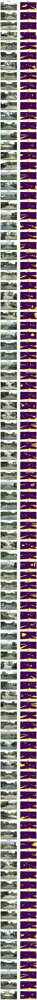

In [1]:
glob_mask = None
import bdlb
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

import torch
import numpy as np
import random

random_seed = 304
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed) # if use multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(random_seed)
random.seed(random_seed)

gts = []
gts_img = []

def visualize_tfdataset(tfdataset, num_samples):
  """Visualizes `num_samples` from the `tfdataset`."""
  
  fig, axs = plt.subplots(num_samples, 2, figsize=(7, 2*num_samples))
  for i, blob in enumerate(tfdataset.take(num_samples)):
    image = blob['image_left'].numpy()
    
    mask = blob['mask'].numpy()
    axs[i][0].imshow(image.astype('int'))
    axs[i][0].axis("off")
    axs[i][0].set(title="Image")
    # map 255 to 2 such that difference between labels is better visible
    
    
    #mask[mask == 255] = 0
    #mask[mask == 1] = 1
    
    gts.append(mask)
    gts_img.append(image)
    
    axs[i][1].imshow(mask[..., 0])
    axs[i][1].axis("off")
    axs[i][1].set(title="Mask")
    
    
  fig.show()

fs = bdlb.load(benchmark="fishyscapes", download_and_prepare=False)
# load the dataset, there is only a validation dataset
ds = fs.get_dataset('LostAndFound')
#ds = fs.get_dataset('Static')
visualize_tfdataset(ds, 100)

In [2]:
random_seed = 304
print("RANDOM_SEED", random_seed)
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed) # if use multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(random_seed)
random.seed(random_seed)

RANDOM_SEED 304


In [3]:
import module.network as network
from module.config import cfg, assert_and_infer_cfg
import module.optimizer as optimizer

import argparse
import torch
import sys


sys.argv = ['hello.py']

parser = argparse.ArgumentParser(description='Semantic Segmentation')
parser.add_argument('--lr', type=float, default=0.01)
parser.add_argument('--arch', type=str, default='network.deepv3.DeepR101V3PlusD_OS8',
                    help='Network architecture. We have DeepSRNX50V3PlusD (backbone: ResNeXt50) \
                    and deepWV3Plus (backbone: WideResNet38).')
parser.add_argument('--dataset', nargs='*', type=str, default='cityscapes',
                    help='a list of datasets; cityscapes')
parser.add_argument('--image_uniform_sampling', action='store_true', default=False,
                    help='uniformly sample images across the multiple source domains')
parser.add_argument('--val_dataset', nargs='*', type=str, default='cityscapes',
                    help='a list consists of cityscapes')
parser.add_argument('--val_interval', type=int, default=100000, help='validation interval')
parser.add_argument('--cv', type=int, default=0,
                    help='cross-validation split id to use. Default # of splits set to 3 in config')
parser.add_argument('--class_uniform_pct', type=float, default=0,
                    help='What fraction of images is uniformly sampled')
parser.add_argument('--class_uniform_tile', type=int, default=1024,
                    help='tile size for class uniform sampling')
parser.add_argument('--coarse_boost_classes', type=str, default=None,
                    help='use coarse annotations to boost fine data with specific classes')

parser.add_argument('--img_wt_loss', action='store_true', default=False,
                    help='per-image class-weighted loss')
parser.add_argument('--cls_wt_loss', action='store_true', default=False,
                    help='class-weighted loss')
parser.add_argument('--batch_weighting', action='store_true', default=False,
                    help='Batch weighting for class (use nll class weighting using batch stats')

parser.add_argument('--jointwtborder', action='store_true', default=False,
                    help='Enable boundary label relaxation')
parser.add_argument('--strict_bdr_cls', type=str, default='',
                    help='Enable boundary label relaxation for specific classes')
parser.add_argument('--rlx_off_iter', type=int, default=-1,
                    help='Turn off border relaxation after specific epoch count')
parser.add_argument('--rescale', type=float, default=1.0,
                    help='Warm Restarts new learning rate ratio compared to original lr')
parser.add_argument('--repoly', type=float, default=1.5,
                    help='Warm Restart new poly exp')

parser.add_argument('--fp16', action='store_true', default=False,
                    help='Use Nvidia Apex AMP')
parser.add_argument('--local_rank', default=0, type=int,
                    help='parameter used by apex library')

parser.add_argument('--sgd', action='store_true', default=True)
parser.add_argument('--adam', action='store_true', default=False)
parser.add_argument('--amsgrad', action='store_true', default=False)
parser.add_argument('--freeze_trunk', action='store_true', default=False)

parser.add_argument('--hardnm', default=0, type=int,
                    help='0 means no aug, 1 means hard negative mining iter 1,' +
                    '2 means hard negative mining iter 2')

parser.add_argument('--trunk', type=str, default='resnet101',
                    help='trunk model, can be: resnet101 (default), resnet50')
parser.add_argument('--max_epoch', type=int, default=180)
parser.add_argument('--max_iter', type=int, default=30000)
parser.add_argument('--max_cu_epoch', type=int, default=100000,
                    help='Class Uniform Max Epochs')
parser.add_argument('--start_epoch', type=int, default=0)
parser.add_argument('--crop_nopad', action='store_true', default=False)
parser.add_argument('--rrotate', type=int,
                    default=0, help='degree of random roate')
parser.add_argument('--color_aug', type=float,
                    default=0.0, help='level of color augmentation')
parser.add_argument('--gblur', action='store_true', default=False,
                    help='Use Guassian Blur Augmentation')
parser.add_argument('--bblur', action='store_true', default=False,
                    help='Use Bilateral Blur Augmentation')
parser.add_argument('--lr_schedule', type=str, default='poly',
                    help='name of lr schedule: poly')
parser.add_argument('--poly_exp', type=float, default=0.9,
                    help='polynomial LR exponent')
parser.add_argument('--bs_mult', type=int, default=2,
                    help='Batch size for training per gpu')
parser.add_argument('--bs_mult_val', type=int, default=1,
                    help='Batch size for Validation per gpu')
parser.add_argument('--crop_size', type=int, default=720,
                    help='training crop size')
parser.add_argument('--pre_size', type=int, default=None,
                    help='resize image shorter edge to this before augmentation')
parser.add_argument('--scale_min', type=float, default=0.5,
                    help='dynamically scale training images down to this size')
parser.add_argument('--scale_max', type=float, default=2.0,
                    help='dynamically scale training images up to this size')
parser.add_argument('--weight_decay', type=float, default=5e-4)
parser.add_argument('--momentum', type=float, default=0.9)
parser.add_argument('--snapshot', type=str, default='data/r101_os8_base_cty.pth')
parser.add_argument('--restore_optimizer', action='store_true', default=False)

parser.add_argument('--city_mode', type=str, default='train',
                    help='experiment directory date name')
parser.add_argument('--date', type=str, default='default',
                    help='experiment directory date name')
parser.add_argument('--exp', type=str, default='default',
                    help='experiment directory name')
parser.add_argument('--tb_tag', type=str, default='',
                    help='add tag to tb dir')
parser.add_argument('--ckpt', type=str, default='logs/ckpt',
                    help='Save Checkpoint Point')
parser.add_argument('--tb_path', type=str, default='logs/tb',
                    help='Save Tensorboard Path')
parser.add_argument('--syncbn', action='store_true', default=True,
                    help='Use Synchronized BN')
parser.add_argument('--dump_augmentation_images', action='store_true', default=False,
                    help='Dump Augmentated Images for sanity check')
parser.add_argument('--test_mode', action='store_true', default=False,
                    help='Minimum testing to verify nothing failed, ' +
                    'Runs code for 1 epoch of train and val')
parser.add_argument('-wb', '--wt_bound', type=float, default=1.0,
                    help='Weight Scaling for the losses')
parser.add_argument('--maxSkip', type=int, default=0,
                    help='Skip x number of  frames of video augmented dataset')
parser.add_argument('--scf', action='store_true', default=False,
                    help='scale correction factor')
parser.add_argument('--dist_url', default='tcp://127.0.0.1:', type=str,
                    help='url used to set up distributed training')
parser.add_argument('--backbone_lr', type=float, default=0.0,
                    help='different learning rate on backbone network')

parser.add_argument('--pooling', type=str, default='mean',
                    help='pooling methods, average is better than max')

parser.add_argument('--ood_dataset_path', type=str,
                    default='/home/nas1_userB/dataset/ood_segmentation/fishyscapes',
                    help='OoD dataset path')

# Anomaly score mode - msp, max_logit, standardized_max_logit
parser.add_argument('--score_mode', type=str, default='mix_test',
                    help='score mode for anomaly [msp, max_logit, standardized_max_logit]')

# Boundary suppression configs
parser.add_argument('--enable_boundary_suppression', type=bool, default=True,
                    help='enable boundary suppression')
parser.add_argument('--boundary_width', type=int, default=4,
                    help='initial boundary suppression width')
parser.add_argument('--boundary_iteration', type=int, default=4,
                    help='the number of boundary iterations')

# Dilated smoothing configs
parser.add_argument('--enable_dilated_smoothing', type=bool, default=True,
                    help='enable dilated smoothing')
parser.add_argument('--smoothing_kernel_size', type=int, default=7,
                    help='kernel size of dilated smoothing')
parser.add_argument('--smoothing_kernel_dilation', type=int, default=6,
                    help='kernel dilation rate of dilated smoothing')

args = parser.parse_args()

In [4]:
# Enable CUDNN Benchmarking optimization
#torch.backends.cudnn.benchmark = True
import time

args.world_size = 1

print(f'World Size: {args.world_size}')
torch.cuda.set_device(args.local_rank)
print('My Rank:', args.local_rank)
# Initialize distributed communication
args.dist_url = args.dist_url + str(8000 + (int(time.time()%1000))//10)

torch.distributed.init_process_group(backend='nccl',
                                     init_method=args.dist_url,
                                     world_size=args.world_size,
                                     rank=args.local_rank)

def get_net():
    """
    Main Function
    """
    # Set up the Arguments, Tensorboard Writer, Dataloader, Loss Fn, Optimizer
    assert_and_infer_cfg(args)

    net = network.get_net(args, criterion=None, criterion_aux=None)

    net = torch.nn.SyncBatchNorm.convert_sync_batchnorm(net)
    net = network.warp_network_in_dataparallel(net, args.local_rank)

    import module
    import os
    
    if args.snapshot:
        epoch, mean_iu = optimizer.load_weights(net, None, None,
                            os.path.dirname(os.path.abspath(module.__file__))+'/'+args.snapshot, args.restore_optimizer)
        print(f"Loading completed. Epoch {epoch} and mIoU {mean_iu}")
    else:
        raise ValueError(f"snapshot argument is not set!")

    class_mean = np.load(os.path.dirname(os.path.abspath(module.__file__))+'/'+f'data/cityscapes_mean_reported.npy', allow_pickle=True)
    class_var = np.load(os.path.dirname(os.path.abspath(module.__file__))+'/'+f'data/cityscapes_var_reported.npy', allow_pickle=True)
    net.module.set_statistics(mean=class_mean.item(), var=class_var.item())

    torch.cuda.empty_cache()
    net.eval()

    return net
net = get_net()

World Size: 1
My Rank: 0
Using pytorch sync batch norm
selem:

tensor([[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]], device='cuda:0')
selem_dilation:

tensor([[0., 1., 0.],
        [1., 1., 1.],
        [0., 1., 0.]], device='cuda:0')
dilation kernel at 1:

tensor([[0., 1., 0.],
        [1., 1., 1.],
        [0., 1., 0.]], device='cuda:0')
dilation kernel at 2:

tensor([[0., 0., 1., 0., 0.],
        [0., 1., 1., 1., 0.],
        [1., 1., 1., 1., 1.],
        [0., 1., 1., 1., 0.],
        [0., 0., 1., 0., 0.]], device='cuda:0')
dilation kernel at 3:

tensor([[0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 1., 1., 1., 0., 0.],
        [0., 1., 1., 1., 1., 1., 0.],
        [1., 1., 1., 1., 1., 1., 1.],
        [0., 1., 1., 1., 1., 1., 0.],
        [0., 0., 1., 1., 1., 0., 0.],
        [0., 0., 0., 1., 0., 0., 0.]], device='cuda:0')
dilation kernel at 4:

tensor([[0., 0., 0., 0., 1., 0., 0., 0., 0.],
        [0., 0., 0., 1., 1., 1., 0., 0., 0.],
        [0., 0., 1., 1., 1., 1.,

In [5]:
features_t = []
def hook_t(module, input, output):
    features_t.append(output.cuda())

net.module.final1.register_forward_hook(hook_t)
net.module.final2.register_forward_hook(hook_t)

In [6]:
val =np.array(gts)[:,:,:,0]
val2 = np.array(gts_img)[:,:,:,:]

In [7]:
val.shape

(100, 1024, 2048)

In [8]:
val2.shape

(100, 1024, 2048, 3)

0it [00:00, ?it/s]

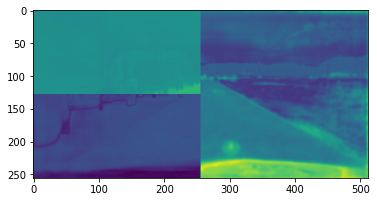

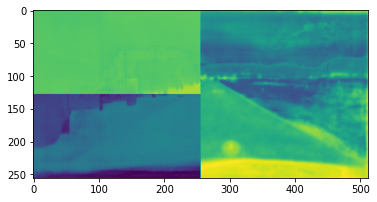

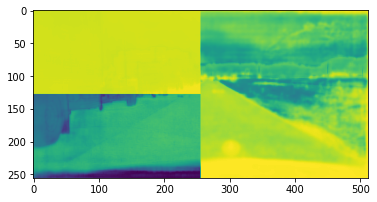

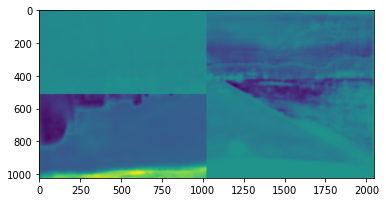

hello.py:164: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
1it [00:01,  1.73s/it]

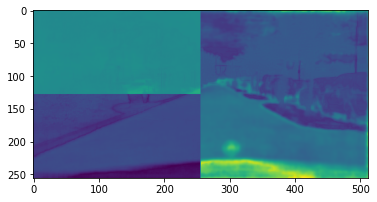

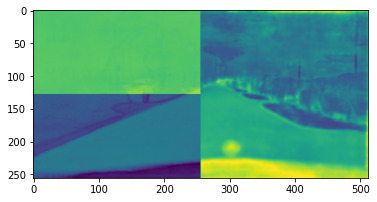

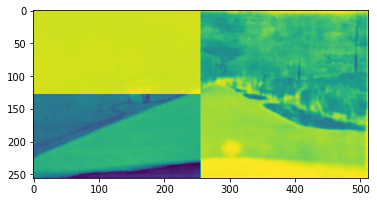

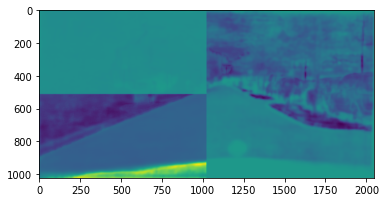

2it [00:02,  1.50s/it]

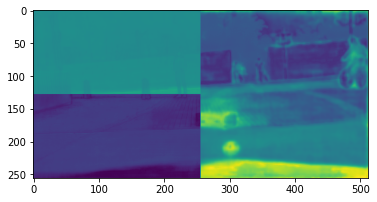

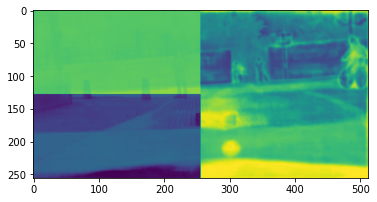

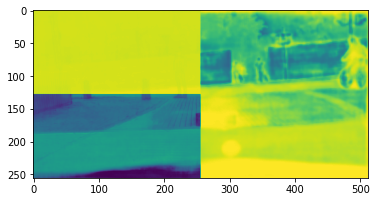

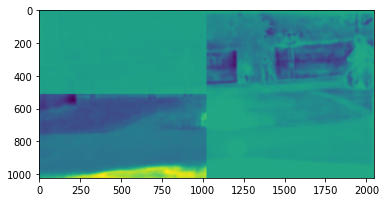

3it [00:03,  1.37s/it]

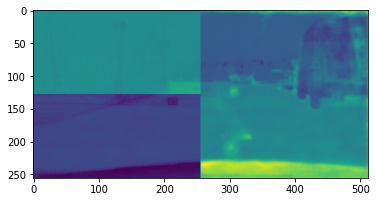

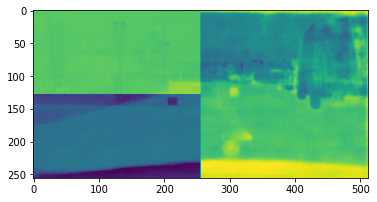

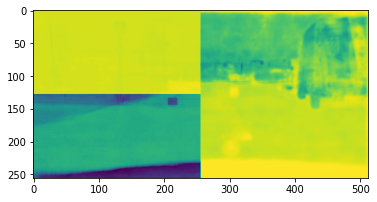

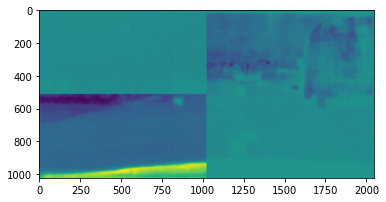

4it [00:04,  1.24s/it]

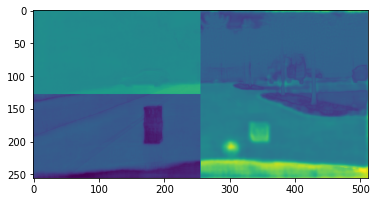

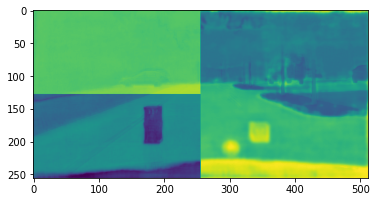

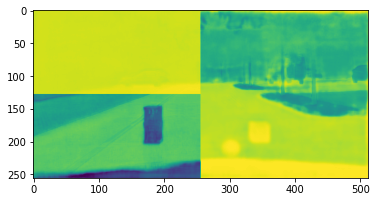

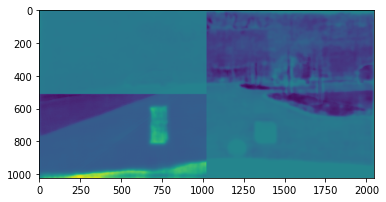

5it [00:05,  1.13s/it]


AP: 0.8253643450463972 FPR95: 0.3896307449991976 auroc: 0.9672879541666093


In [9]:
import argparse
import torch
from torchvision import transforms, datasets
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import cv2
import numpy as np
import os
import glob
import shutil
import time
from torchvision.models import resnet18, resnet101
from PIL import Image
from sklearn.metrics import roc_auc_score

os.environ["CUDA_VISIBLE_DEVICES"]="1"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

mean_train = [0.485, 0.456, 0.406]
std_train = [0.229, 0.224, 0.225]



def val_data_transforms(load_size=256, mean_train=mean_train, std_train=std_train):
    data_transforms = transforms.Compose([
            #transforms.Resize((load_size, load_size), Image.ANTIALIAS),
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_train,
                                std=std_train)
            ])
    return data_transforms

num = 0
var_n = []
var_a = []
sml_n = []
sml_a = []
esm_n = []
esm_a = []
fin_n = []
fin_a = []
def estimator(image):
    global num
    global features_t
    global val
    global ret
    features_t = []
    #print(np.array(image).shape)
    """Assigns a random uncertainty per pixel."""
    val_data_transform = val_data_transforms(load_size=768, mean_train=mean_train, std_train=std_train)
    test_img = Image.fromarray(np.array(image))
    test_img = val_data_transform(test_img)
    test_img = torch.unsqueeze(test_img, 0).to(device)
    with torch.set_grad_enabled(False):
        main_out, anomaly_score, max_logit, variance, mixed, SML = net(test_img)
   
    out2 = variance
    out3 = SML
    out4 = anomaly_score
    #get variance distribution
    
    
    var_n.append(-out2[0,...][val[num, :, :] == 0])
    var_a.append(-out2[0,...][val[num, :, :] == 1])
    
    sml_n.append(-out3[0,...][val[num, :, :] == 0])
    sml_a.append(-out3[0,...][val[num, :, :] == 1])
    
    esm_n.append(-out4[0,...][val[num, :, :] == 0])
    esm_a.append(-out4[0,...][val[num, :, :] == 1])
    
    
    #out3[:] = torch.max(out4)
    #out3[0,...][val[num, :, :] == 0] = -99
    #out3[0,...][val[num, :, :] == 1] = out4[0,...][val[num, :, :] == 1]
    
    #out3[:] = torch.max(out4)
    #out3[0,...][val[num, :, :] == 0] = out4[0,...][val[num, :, :] == 0]
    
    
    out2 = anomaly_score#SML#anomaly_score#main_out.detach().var(1) 
    new_logit = -out2.clone()#-main_out.detach().var(1).clone()
    
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(256, 512), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    feats =  features_t[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)
    new_logit = new_logit.detach().cpu()
    #new_logit[:] = torch.median(new_logit)
    
    maps = torch.ones(1, 256, 512)
    
    new_logit[:][0, :128, :256] = 0.5
    new_logit[:][0, 128:, :256] = 0
    for i in range(3):
        feats = (((1-new_logit.cuda()) * feats) + ((new_logit.cuda()) * torch.max(feats) ))
        output = net.module.final2(feats)
        anomaly_score, _ = output.detach().max(1)
        new_logit = anomaly_score.detach().cpu()
        
        new_logit = new_logit.detach().cpu()
        new_logit -= torch.min(new_logit)
        new_logit /= torch.max(new_logit)
        
        maps[:] = new_logit
        
        plt.imshow(new_logit[0])
        plt.show(block=True)
    
    new_logit = maps
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(1024, 2048), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    
    #fin_n.append(new_logit[0, ...][val[num, :, :] == 0])
    #fin_a.append(new_logit[0, ...][val[num, :, :] == 1])
    
    out3 = -out2.detach().cpu()[0]
    out4 = -out2.detach().cpu()[0]
    #out3 = out3
    #out3 -= torch.min(out3)
    #out3 /= torch.max(out3)
    
    #out3 /= torch.abs(torch.min(out3))
    #out3 -= 0.5
    
    new_logit = new_logit[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)
    
    norm_logit = new_logit
    final_output =  out3 * (1-norm_logit) 
    #print(torch.max(out3))
    #print(torch.mean(out3))
    #print(torch.min(out3))
    
    fin_n.append(out3[...][val[num, :, :] == 0])
    fin_a.append(out3[...][val[num, :, :] == 1])
    
    #fin_n.append(1-norm_logit[...][val[num, :, :] == 0])
    #fin_a.append(1-norm_logit[...][val[num, :, :] == 1])
    
    #plt.imshow(out3)
    #plt.show(block=True)
    
    #print(torch.min(out3))
    #print(torch.max(out3))
    
    #plt.imshow((norm_logit))
    #plt.show(block=True)
    
    #print(torch.min(norm_logit))
    #print(torch.max(norm_logit))
    
    plt.imshow(final_output)
    plt.show(block=True)
    
    #print(torch.min(final_output))
    #print(torch.max(final_output))
    
    num += 1
    return torch.tensor(final_output.detach().cpu())

metrics = fs.evaluate(estimator, ds.take(5))

#plt.plot(metrics['recall'], metrics['precision'])
#plt.xlabel('recall')
#plt.ylabel('precision')
#plt.show()
print("AP: " + str(metrics['AP']) + " FPR95: " + str(metrics['FPR@95%TPR']) +  " auroc: " + str(metrics['auroc']))

In [10]:
net.module.final2

Sequential(
  (0): Conv2d(256, 19, kernel_size=(1, 1), stride=(1, 1))
)

In [26]:
import argparse
import torch
from torchvision import transforms, datasets
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import cv2
import numpy as np
import os
import glob
import shutil
import time
from torchvision.models import resnet18, resnet101
from PIL import Image
from sklearn.metrics import roc_auc_score

os.environ["CUDA_VISIBLE_DEVICES"]="1"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

mean_train = [0.485, 0.456, 0.406]
std_train = [0.229, 0.224, 0.225]



def val_data_transforms(load_size=256, mean_train=mean_train, std_train=std_train):
    data_transforms = transforms.Compose([
            #transforms.Resize((load_size, load_size), Image.ANTIALIAS),
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_train,
                                std=std_train)
            ])
    return data_transforms

num = 0
var_n = []
var_a = []
sml_n = []
sml_a = []
esm_n = []
esm_a = []
fin_n = []
fin_a = []

floor = []
other = []
all_cl= [ [] for x in range(19) ]
def estimator(image):
    global num
    global features_t
    global val
    global ret
    features_t = []
    #print(np.array(image).shape)
    """Assigns a random uncertainty per pixel."""
    val_data_transform = val_data_transforms(load_size=768, mean_train=mean_train, std_train=std_train)
    test_img = Image.fromarray(np.array(image))
    test_img = val_data_transform(test_img)
    test_img = torch.unsqueeze(test_img, 0).to(device)
    with torch.set_grad_enabled(False):
        main_out, anomaly_score, max_logit, variance, mixed, SML = net(test_img)
   
    out2 = variance
    out3 = SML
    out4 = anomaly_score
    #get variance distribution
    return (-out4.detach().cpu())
    
    var_n.append(-out2[0,...][val[num, :, :] == 0])
    var_a.append(-out2[0,...][val[num, :, :] == 1])
    
    sml_n.append(-out3[0,...][val[num, :, :] == 0])
    sml_a.append(-out3[0,...][val[num, :, :] == 1])
    
    esm_n.append(-out4[0,...][val[num, :, :] == 0])
    esm_a.append(-out4[0,...][val[num, :, :] == 1])
    
    
    #out3[:] = torch.max(out4)
    #out3[0,...][val[num, :, :] == 0] = -99
    #out3[0,...][val[num, :, :] == 1] = out4[0,...][val[num, :, :] == 1]
    
    #out3[:] = torch.max(out4)
    #out3[0,...][val[num, :, :] == 0] = out4[0,...][val[num, :, :] == 0]
    
    
    out2 = anomaly_score#SML#anomaly_score#main_out.detach().var(1) 
    new_logit = -out2.clone()#-main_out.detach().var(1).clone()
    
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(256, 512), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    feats =  features_t[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)
    anomaly_score_new_logit = new_logit.detach().cpu()
    #new_logit[:] = torch.median(new_logit)
    
    maps = torch.ones(1, 256, 512)
    
    #plt.imshow(anomaly_score_new_logit.detach().cpu()[0])
    #plt.show(block=True)
    
    
    
    for i in range(3):
        feats = (((1-new_logit.cuda()) * feats) + ((new_logit.cuda()) * torch.max(feats) ))
        output = net.module.final2(feats)
        anomaly_score, prediction = output.detach().max(1)
        new_logit = anomaly_score.detach().cpu()
        
        #print("iter " + str(i))
        if True:
            for c in range(19):
                if torch.sum(prediction[0]==c) > 0:
                    #print(c)
                    #print(torch.sum(prediction[0]==c) )
                    all_cl[c].append(torch.mean(feats[0,:,prediction[0]==c],1).unsqueeze(0) )
        
        new_logit = new_logit.detach().cpu()[0]
        new_logit -= torch.min(new_logit)
        new_logit /= torch.max(new_logit)
        
        maps[:] = new_logit
        
        #plt.imshow(new_logit)
        #plt.show(block=True)
    
    new_logit = maps
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(1024, 2048), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    
    
    #fin_n.append(new_logit[0,...][val[num, :, :] == 0])
    #fin_a.append(new_logit[0,...][val[num, :, :] == 1])
    
    #fin_n.append(new_logit[0, ...][val[num, :, :] == 0])
    #fin_a.append(new_logit[0, ...][val[num, :, :] == 1])
    
    out3 = -out2.detach().cpu()[0]
    out4 = -out2.detach().cpu()[0]
    out3 = out3
    
    #out3 /= torch.abs(torch.min(out3))
    #out3 -= 0.5
    
    new_logit = new_logit[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)
    
    norm_logit = new_logit
    final_output =  out3 * (1-norm_logit) 
    #print(torch.max(out3))
    #print(torch.mean(out3))
    #print(torch.min(out3))
    
    fin_n.append(out3[...][val[num, :, :] == 0])
    fin_a.append(out3[...][val[num, :, :] == 1])
    
    
    num += 1
    return torch.tensor(final_output.detach().cpu())

metrics = fs.evaluate(estimator, ds.take(100))

#plt.plot(metrics['recall'], metrics['precision'])
#plt.xlabel('recall')
#plt.ylabel('precision')
#plt.show()
print("AP: " + str(metrics['AP']) + " FPR95: " + str(metrics['FPR@95%TPR']) +  " auroc: " + str(metrics['auroc']))

100it [00:29,  3.43it/s]


AP: 0.4549017036821219 FPR95: 0.12478716041704027 auroc: 0.973436110133154


In [ ]:
#AP: 0.3609780606214042 FPR95: 0.3141383881287457 auroc: 0.9457083863452311
#AP: 0.3642827948155092 FPR95: 0.1458737015216164 auroc: 0.9687733653774723
#AP: 0.4549017036821219 FPR95: 0.12478716041704027 auroc: 0.973436110133154

In [12]:
import matplotlib.pyplot as plt
normal = torch.cat(var_n)
anomaly =torch.cat(var_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 200000)  
ret_normal_var = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 200000)  
ret_anomaly_var = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_var
x1 = ret_anomaly_var

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))


fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

/usr/local/lib/python3.6/dist-packages/IPython/utils/traitlets.py:5: UserWarning:

IPython.utils.traitlets has moved to a top-level traitlets package.



In [13]:
import matplotlib.pyplot as plt
normal = torch.cat(sml_n)
anomaly =torch.cat(sml_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 200000)  
ret_normal_sml = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 200000)  
ret_anomaly_sml = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_sml
x1 = ret_anomaly_sml

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))

fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

In [14]:
import matplotlib.pyplot as plt
normal = torch.cat(esm_n)
anomaly =torch.cat(esm_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 100000)  
ret_normal_esm = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 100000)  
ret_anomaly_esm = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_esm
x1 = ret_anomaly_esm

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))

fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

In [15]:
import matplotlib.pyplot as plt
normal = torch.cat(fin_n)
anomaly =torch.cat(fin_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 100000)  
ret_normal_esm = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 100000)  
ret_anomaly_esm = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_esm
x1 = ret_anomaly_esm

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))

fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

In [16]:
import matplotlib.pyplot as plt
normal = torch.cat(fin_n)
anomaly =torch.cat(fin_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 100000)  
ret_normal_esm = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 100000)  
ret_anomaly_esm = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_esm
x1 = ret_anomaly_esm

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))

fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

In [17]:
import matplotlib.pyplot as plt
normal = torch.cat(fin_n)
anomaly =torch.cat(fin_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 100000)  
ret_normal_esm = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 100000)  
ret_anomaly_esm = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_esm
x1 = ret_anomaly_esm

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))

fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

In [18]:
import matplotlib.pyplot as plt
normal = torch.cat(fin_n)
anomaly =torch.cat(fin_a)


ret_normal_ori = np.array(normal.detach().cpu().numpy())
index = np.random.choice(ret_normal_ori.shape[0], 100000)  
ret_normal_esm = ret_normal_ori[index]

ret_anomaly = np.array(anomaly.detach().cpu().numpy())
index = np.random.choice(ret_anomaly.shape[0], 100000)  
ret_anomaly_esm = ret_anomaly[index]
#plt.hist(ret_anomaly)
#plt.hist(ret_normal)

#plt.show()


import plotly.graph_objects as go
import numpy as np

x0 = ret_normal_esm
x1 = ret_anomaly_esm

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0, marker_color='blue', name='normal'))
fig.add_trace(go.Histogram(x=x1, marker_color='red', name='anomaly'))

fig.update_layout(barmode="overlay")
fig.update_traces(opacity=0.80)
fig.show()

In [19]:

#plt.bar(range(256), torch.mean(torch.cat(floor, 0), 0).detach().cpu())
#plt.show()

#print(torch.max(torch.mean(torch.cat(floor, 0), 0)))
#print(torch.mean(torch.mean(torch.cat(floor, 0), 0)))

#for i in range(19):
#    target = all_cl[i] # other
#    if (len(target) > 0):
#        plt.bar(range(256), torch.mean(torch.cat(target, 0), 0).detach().cpu())
#        plt.show()

#        print(torch.max(torch.mean(torch.cat(target, 0), 0)))
#        print(torch.mean(torch.mean(torch.cat(target, 0), 0)))

In [20]:
dist = np.linalg.norm(ret_normal_var-ret_anomaly_var)
print(dist)
dist = np.linalg.norm(ret_normal_sml-ret_anomaly_sml)
print(dist)
dist = np.linalg.norm(ret_normal_esm-ret_anomaly_esm)
print(dist)


1046.3079
1116.3464
1490.6685


In [21]:
import plotly.graph_objects as go

import numpy as np

x0 = ret_normal
x1 = ret_anomaly

#x0 = np.random.randn(2000)
#x1 = np.random.randn(2000) + 1

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0))
fig.add_trace(go.Histogram(x=x1))

# The two histograms are drawn on top of another
#fig.update_yaxes(type="log")
fig.update_layout(barmode='stack')
fig.show()

NameError: name 'ret_normal' is not defined

In [ ]:
import plotly.graph_objects as go

import numpy as np

x0 = ret_normal
x1 = ret_anomaly

fig = go.Figure()
fig.add_trace(go.Histogram(x=x0))
fig.add_trace(go.Histogram(x=x1))

# The two histograms are drawn on top of another
fig.update_layout(barmode='stack')
fig.show()

In [ ]:
import argparse
import torch
from torchvision import transforms, datasets
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import cv2
import numpy as np
import os
import glob
import shutil
import time
from torchvision.models import resnet18, resnet101
from PIL import Image
from sklearn.metrics import roc_auc_score

os.environ["CUDA_VISIBLE_DEVICES"]="1"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

mean_train = [0.485, 0.456, 0.406]
std_train = [0.229, 0.224, 0.225]

def val_data_transforms(load_size=256, mean_train=mean_train, std_train=std_train):
    data_transforms = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=mean_train,
                                std=std_train)
            ])
    return data_transforms


def estimator(image):
    global num
    global features_t
    features_t = []
    val_data_transform = val_data_transforms(load_size=768, mean_train=mean_train, std_train=std_train)
    test_img = Image.fromarray(np.array(image))
    test_img = val_data_transform(test_img)
    test_img = torch.unsqueeze(test_img, 0).to(device)
    with torch.set_grad_enabled(False):
        out, out2 = net(test_img)
   
    logit2, predction01 = features_t[1].detach().cpu().max(1)
    new_logit = -out2.clone()
    
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(256, 512), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    feats =  features_t[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)

    maps = torch.ones(1, 256, 512)
    
    for i in range(3):
        #print(features_t[0].shape)
        #print(new_logit.shape)
        feats = (((1-new_logit.cuda()) * feats) + ((new_logit.cuda()) * torch.max(feats) ))
        #print(output.shape)
        output = net.module.final2(feats)
        anomaly_score, _ = output.detach().max(1)
        new_logit = anomaly_score.detach().cpu() 
        
        new_logit = new_logit.detach().cpu()[0]
        new_logit -= torch.min(new_logit)
        new_logit /= torch.max(new_logit)
        
    maps[:] = new_logit
    
    new_logit = -out2.clone()
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(256, 512), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    feats =  features_t[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)
    
    maps_val = torch.ones(1, 256, 512)
    for i in range(2):
        feats = (((1-new_logit.cuda()) * feats) + ((new_logit.cuda()) * torch.max(feats) ))
        output = net.module.final2(feats)
        anomaly_score, _ = output.detach().max(1)
        new_logit = output.detach().cpu().var(1) 
        
        new_logit = new_logit.detach().cpu()[0]
        new_logit -= torch.min(new_logit)
        new_logit /= torch.max(new_logit)

        maps_val *= new_logit
        
    new_logit = maps
    new_logit = new_logit.unsqueeze(1)
    new_logit = F.interpolate(new_logit, size=(1024, 2048), mode='bilinear', align_corners=True)
    new_logit = new_logit.squeeze(1)
    
    new_logit2 = maps_val
    new_logit2 = new_logit.unsqueeze(1)
    new_logit2 = F.interpolate(new_logit2, size=(1024, 2048), mode='bilinear', align_corners=True)
    new_logit2 = new_logit2.squeeze(1)
    
    
    out3 = -out2.detach().cpu()[0]
    
    new_logit = new_logit[0]
    new_logit -= torch.min(new_logit)
    new_logit /= torch.max(new_logit)
    
    norm_logit = new_logit
    
    new_logit2 = new_logit2[0]
    new_logit2 -= torch.min(new_logit2)
    new_logit2 /= torch.max(new_logit2)
    
    new_logit2 += torch.min(out3)
    new_logit2 *= (torch.max(out3)-torch.min(out3))
    final_output = out3
    
    del out
    return torch.tensor(final_output.detach().cpu())

metrics = fs.evaluate(estimator, ds.take(5))
print("AP: " + str(metrics['AP']) + " FPR95: " + str(metrics['FPR@95%TPR']) +  " auroc: " + str(metrics['auroc']))